In [1]:
import cv2;
import numpy as np;
import matplotlib.pyplot as plt;

In [2]:
plt.rcParams["figure.dpi"] = 300;
plt.figure(figsize=(40, 30));
plt.rcParams['xtick.labelsize']=4;
plt.rcParams['ytick.labelsize']=4;

<Figure size 12000x9000 with 0 Axes>

In [3]:
from DCP import DCP

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


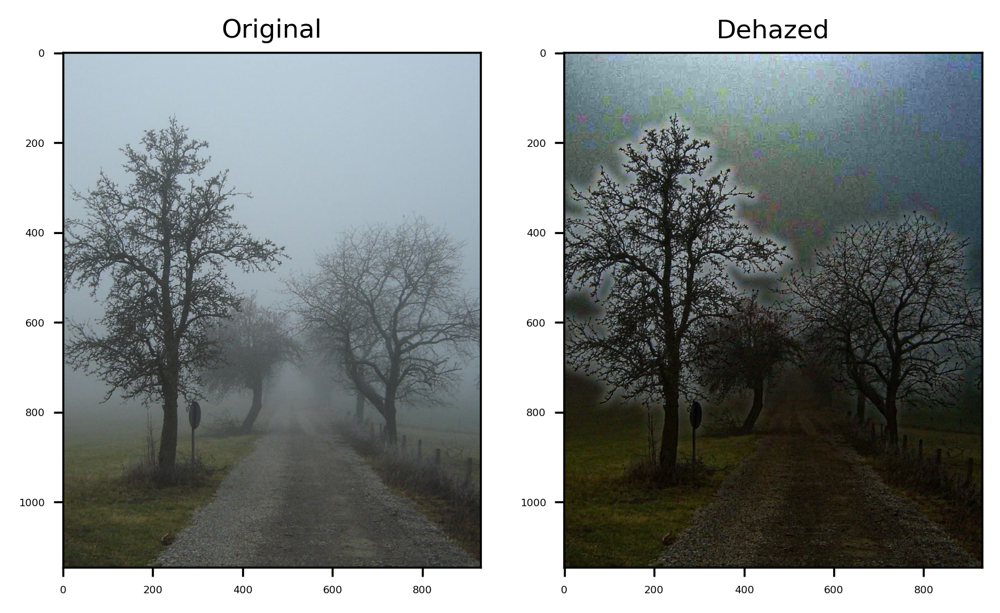

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


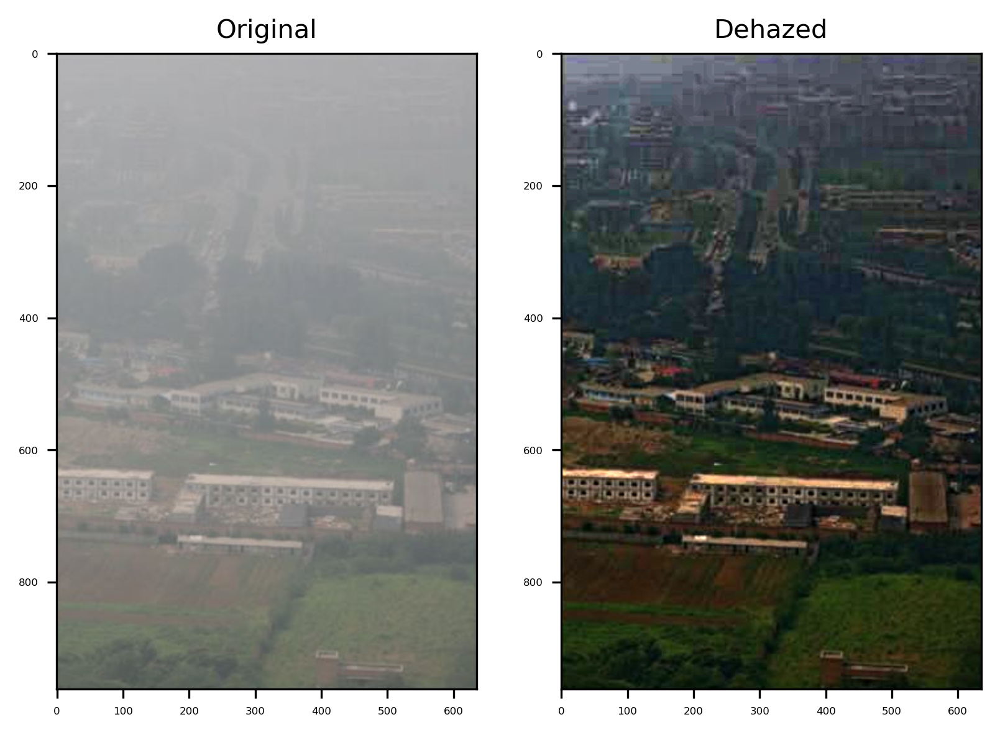

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


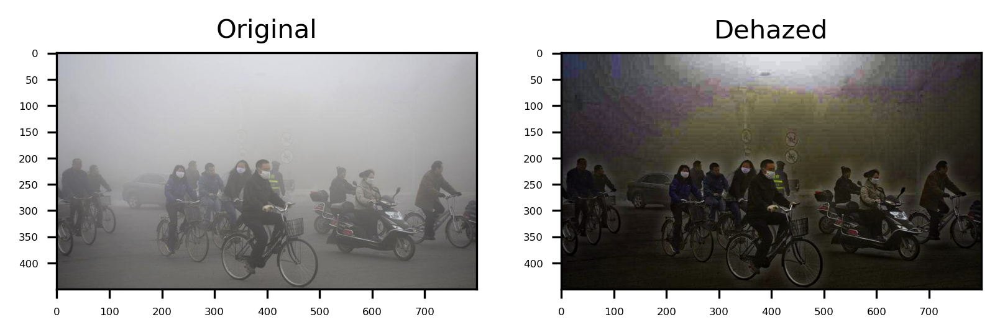

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


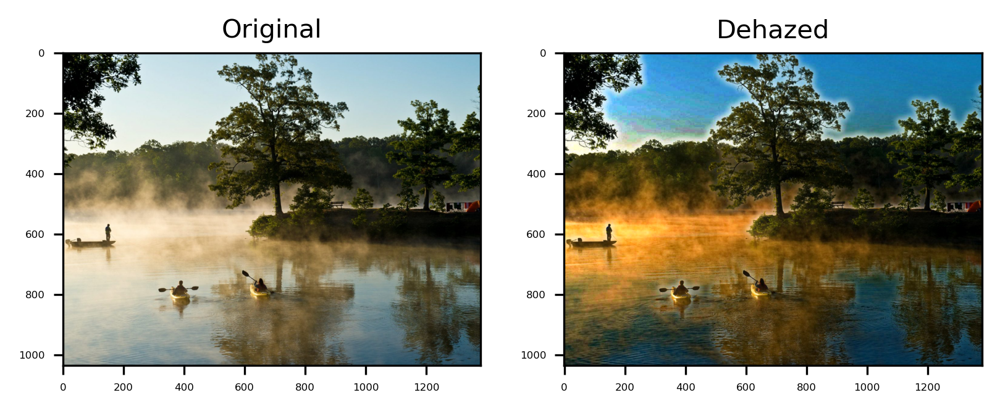

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


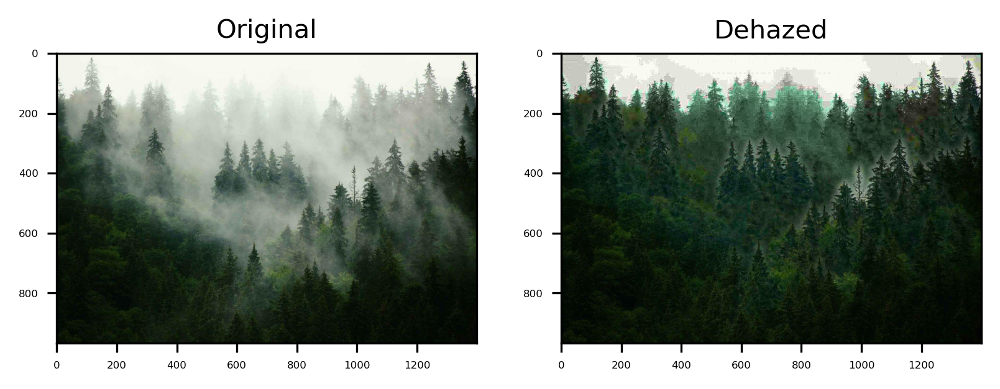

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


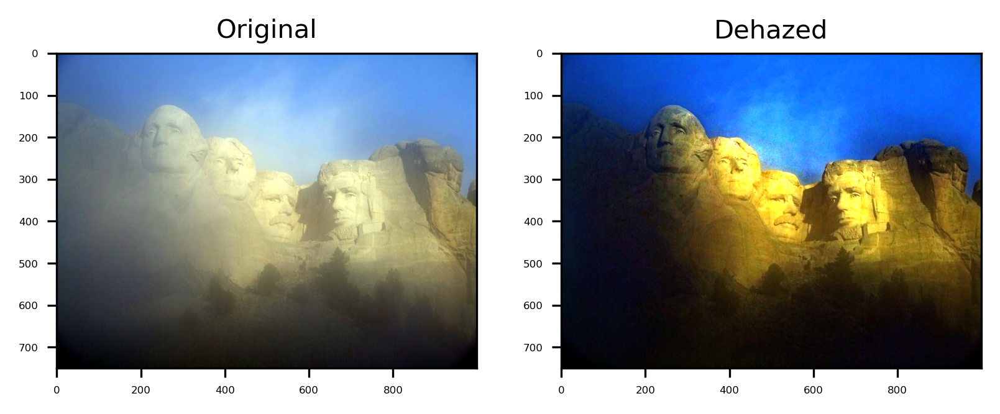

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


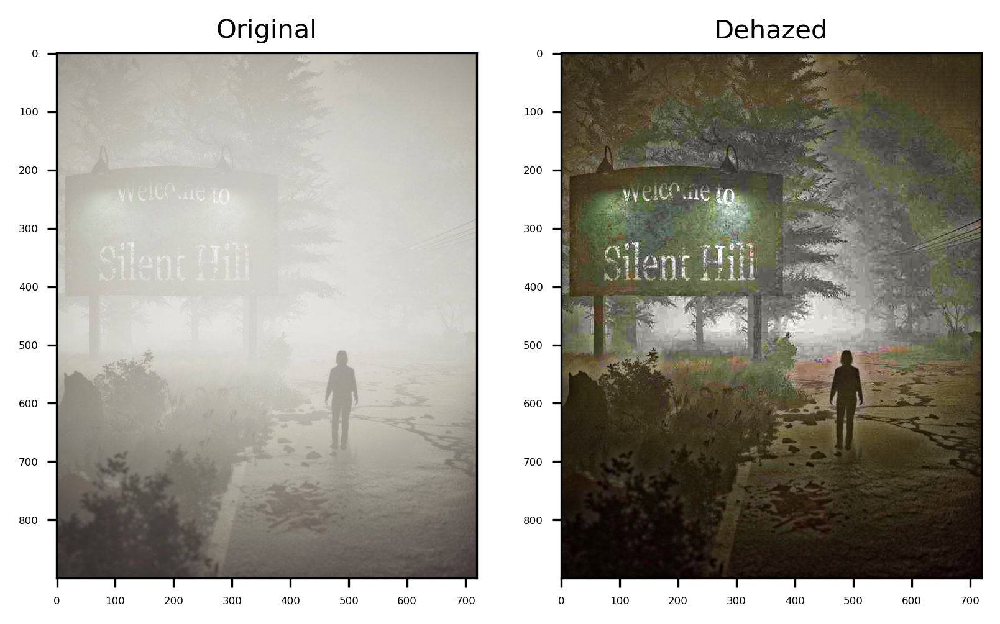

In [4]:
genuine_fog = ['1.png', '2.png', '3.png', '4.png', '5.png', '6.png', '7.png']

for img in genuine_fog:
    dcp_element = DCP(image_path = img, kernel_size = 5, tx = 0.1, r = 10, eps = 5e-3, omega = 0.95)
    out_ = dcp_element.apply()
    
    rgb_out = cv2.cvtColor(out_.astype('float32'), cv2.COLOR_BGR2RGB)
    src = cv2.imread(img)
    rgb_src = cv2.cvtColor(src.astype('float32')/255, cv2.COLOR_BGR2RGB)
    
    plt.subplot(1,2,1)
    plt.imshow(rgb_src, cmap = plt.cm.Spectral)
    plt.title('Original', fontsize = 10)

    plt.subplot(1,2,2)
    plt.imshow(rgb_out, cmap = plt.cm.Spectral)
    plt.title('Dehazed', fontsize = 10)
    
    plt.show()
    

In [7]:
from skimage.metrics import mean_squared_error, structural_similarity
import imgaug.augmenters as iaa
import itertools
from tqdm import tqdm

In [59]:
kernel_size = [5,15,25,35]
tx = [0.1, 0.15, 0.2]
r = [5,10,15]
omega = [0.75, 0.8, 0.85, 0.9]
c = list(itertools.product(kernel_size, tx, r, omega))

In [8]:
generated_fog = ['big_ben.png', 'senna.png', 'rashmore.png', 'louvre.png', 'bundestag.png', 'colliseum.png', 'kremlin.png']

In [43]:
loss_mse_d = 10000, 10000
c_1 = None
c_2 = None
c_1_d = None
c_2_d = None

for pars_ in tqdm(c):
    
    ss_loss = []
    mse_loss = []
    
    ss_loss_d = []
    mse_loss_d = []
    
    for img in generated_fog:
    
        src = cv2.imread(img)
        aug = iaa.Fog(random_state = 2023)
        augmented = aug.augment_image(src)
        augmented_double = aug.augment_image(augmented)
    
        dcp_element = DCP(image_path = augmented, kernel_size = pars_[0], tx = pars_[1], r = pars_[2], eps = 5e-3, omega = pars_[3])
        out_ = dcp_element.apply()
    
        dcp_element = DCP(image_path = augmented_double, kernel_size = pars_[0], tx = pars_[1], r = pars_[2], eps = 5e-3, omega = pars_[3])
        out_double = dcp_element.apply()
    
        #metrics recover to orig (once)
        out_recover = out_.astype('float64')*255
        mse_recover = mean_squared_error(out_recover, src)
        sim_recover = structural_similarity(out_recover, src, channel_axis = 2, data_range = 255)
    
        # metrics recover to orig (twice)
        out_recover_double = out_double.astype('float64')*255
        mse_recover_double = mean_squared_error(out_recover_double, src)
        sim_recover_double = structural_similarity(out_recover_double, src, channel_axis = 2, data_range = 255)
    
        ss_loss.append(sim_recover)
        mse_loss.append(mse_recover)
        
        ss_loss_d.append(sim_recover_double)
        mse_loss_d.append(mse_recover_double)
    
    run_ss = np.mean(ss_loss)
    run_mse = np.mean(mse_loss)
    
    run_ss_d = np.mean(ss_loss_d)
    run_mse_d = np.mean(mse_loss_d)
    
    if run_ss > loss_sim:
        c_1 = pars_
        loss_sim = run_ss
        
    if run_mse < loss_mse:
        c_2 = pars_
        loss_mse = run_mse
    
    if run_ss_d > loss_sim_d:
        c_1_d = pars_
        loss_sim_d = run_ss_d
        
    if run_mse_d < loss_mse_d:
        c_2_d = pars_
        loss_mse_d = run_mse_d

100%|█████████████████████████████████████████| 144/144 [33:25<00:00, 13.92s/it]


In [65]:
print('Best params for simmilarity on once hazed {}, {}, {}, {} with sim - {:.0%}'.format(c_1[0], c_1[1], c_1[2], c_1[3], loss_sim))
print('Best params for MSE on once hazed {}, {}, {}, {} wirh sim - {:.1f}'.format(c_2[0], c_2[1], c_2[2], c_2[3], loss_mse))
print('Best params for simmilarity on twice hazed {}, {}, {}, {} wirh sim - {:.0%}'.format(c_1_d[0], c_1_d[1], c_1_d[2], c_1_d[3], loss_sim_d))
print('Best params for MSE on twice hazed {}, {}, {}, {} wirh sim - {:.1f}'.format(c_2_d[0], c_2_d[1], c_2_d[2], c_2_d[3], loss_mse_d))

Best params for simmilarity on once hazed 5, 0.1, 15, 0.8 with sim - 92%
Best params for MSE on once hazed 5, 0.1, 15, 0.75 wirh sim - 1281.7
Best params for simmilarity on twice hazed 5, 0.15, 15, 0.9 wirh sim - 76%
Best params for MSE on twice hazed 5, 0.1, 15, 0.9 wirh sim - 3181.5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


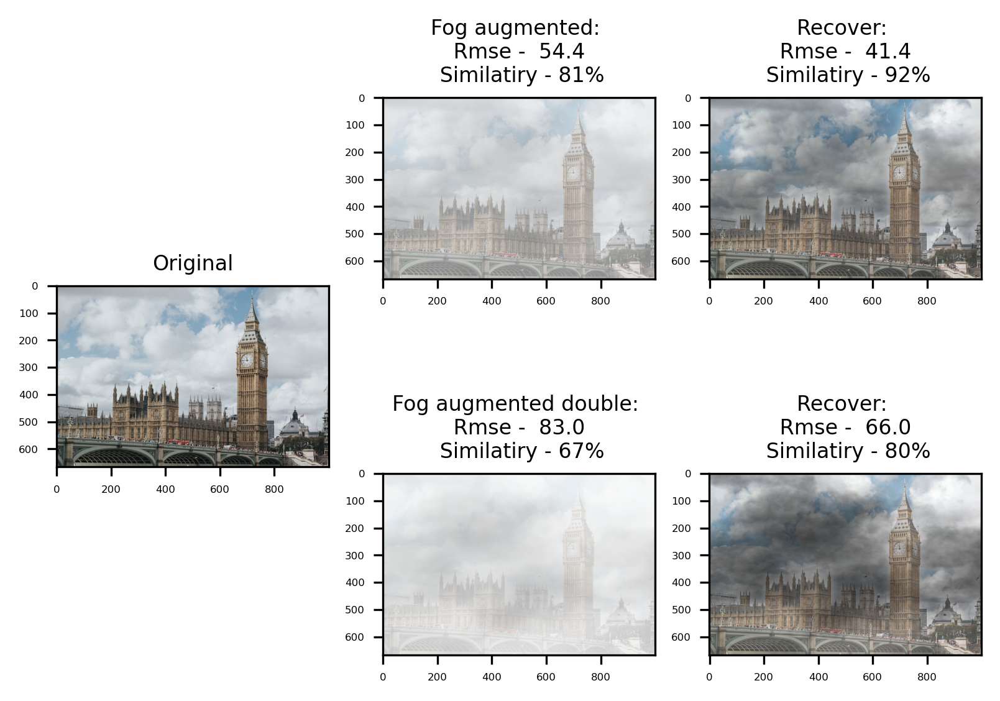

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


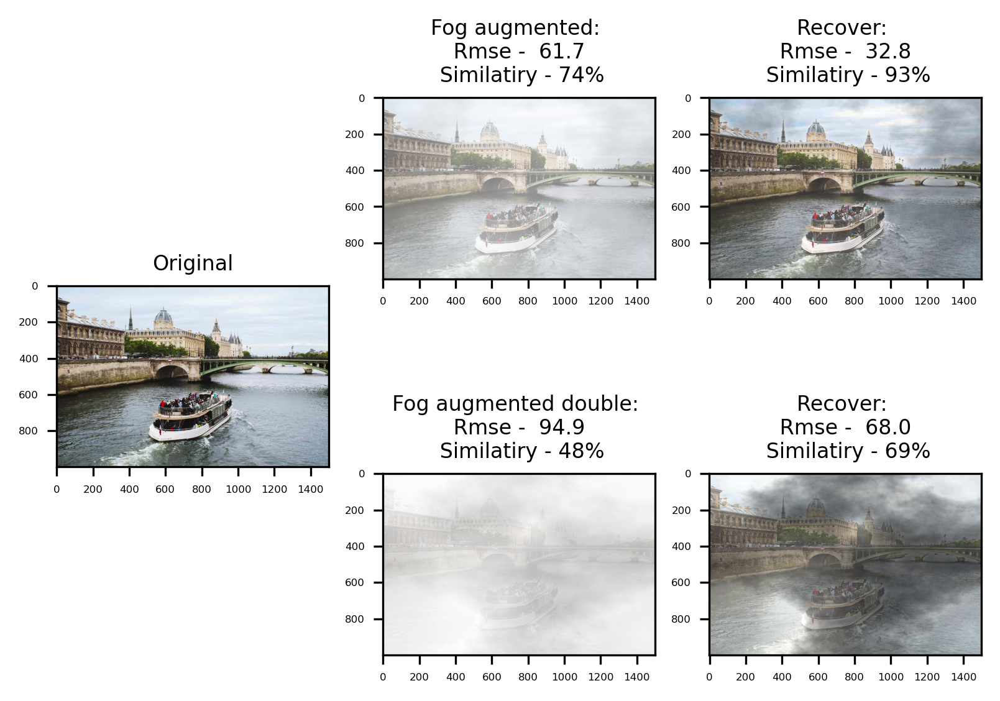

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


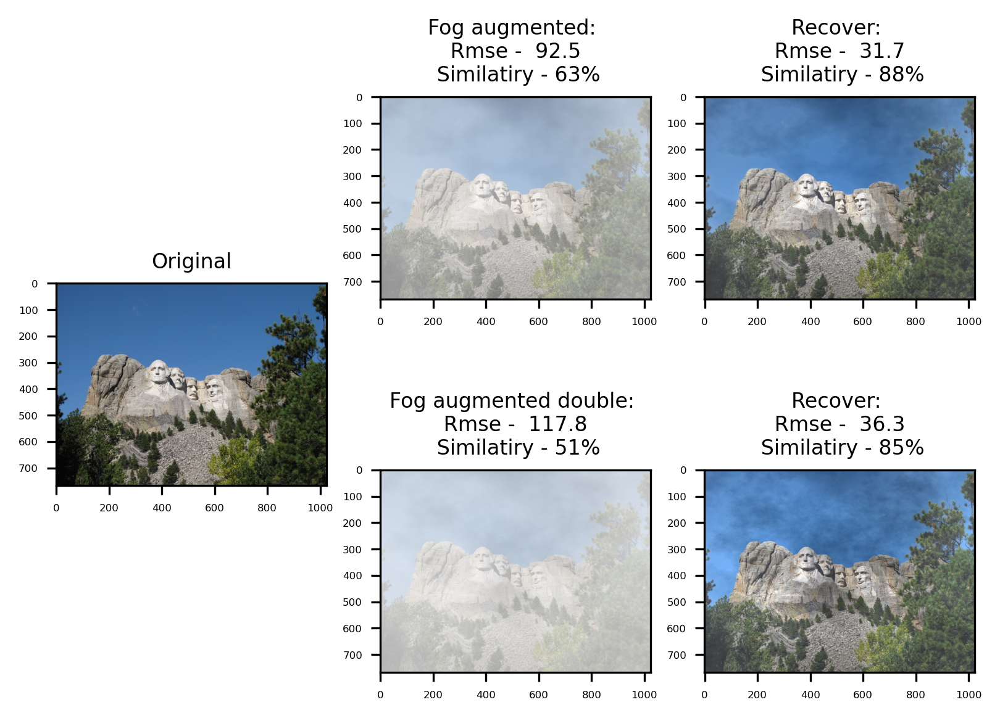

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


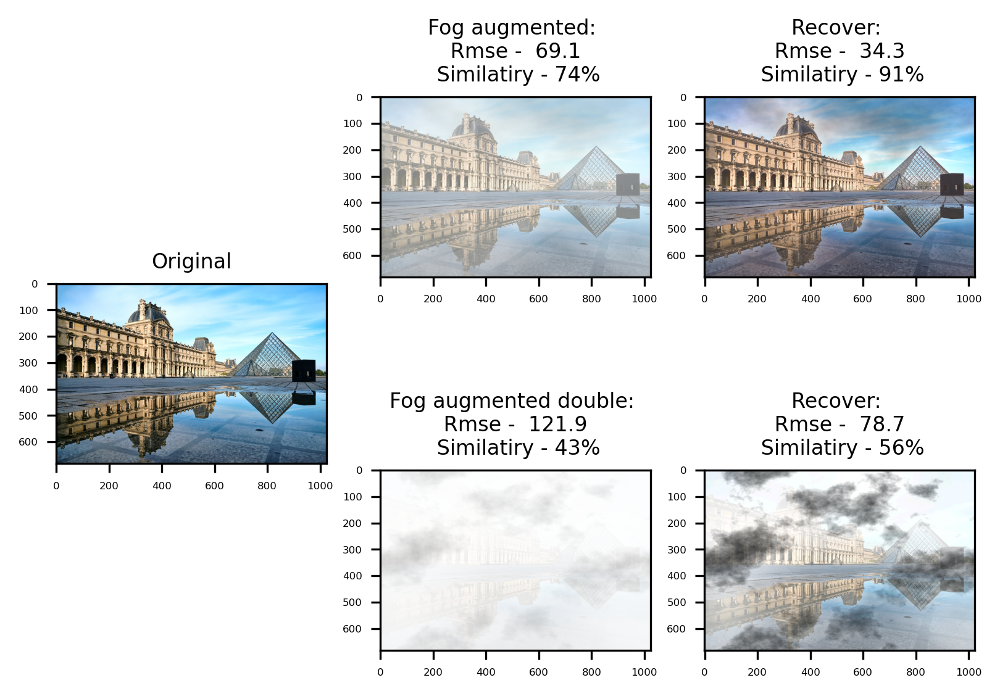

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


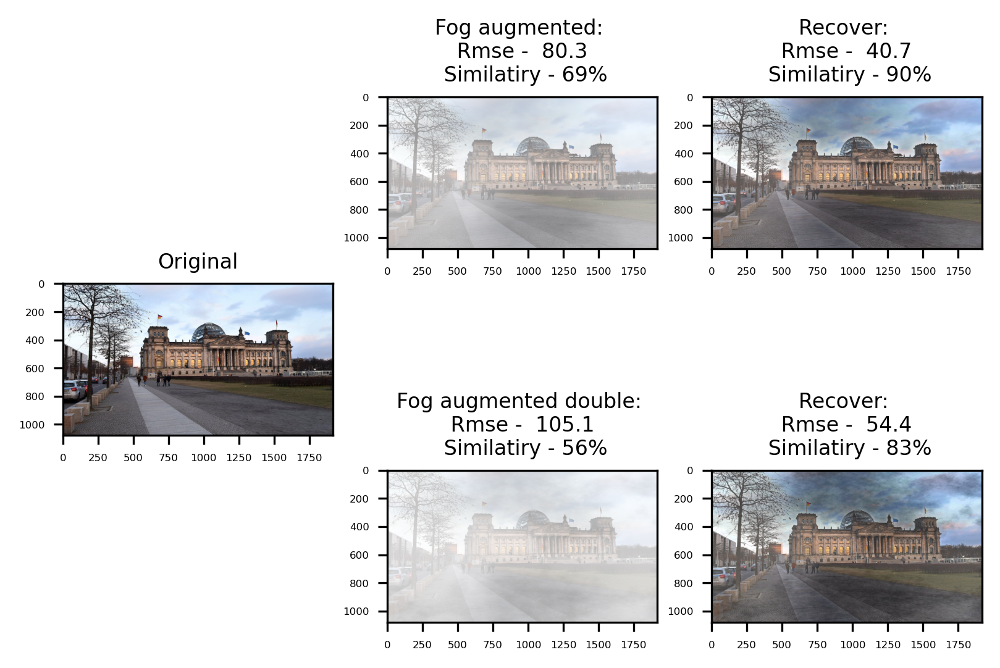

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


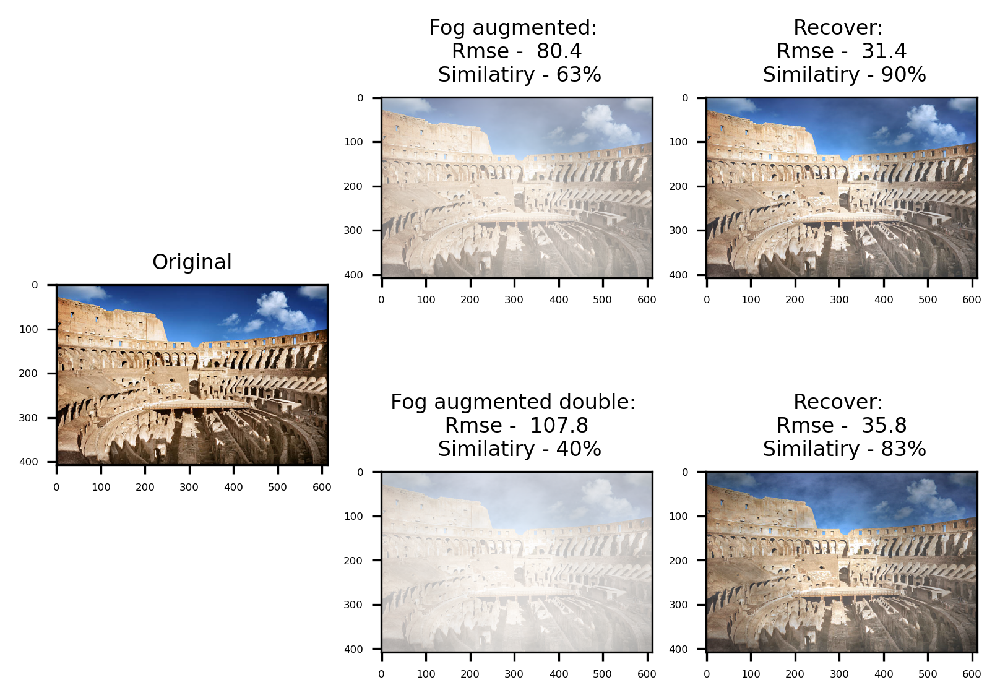

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


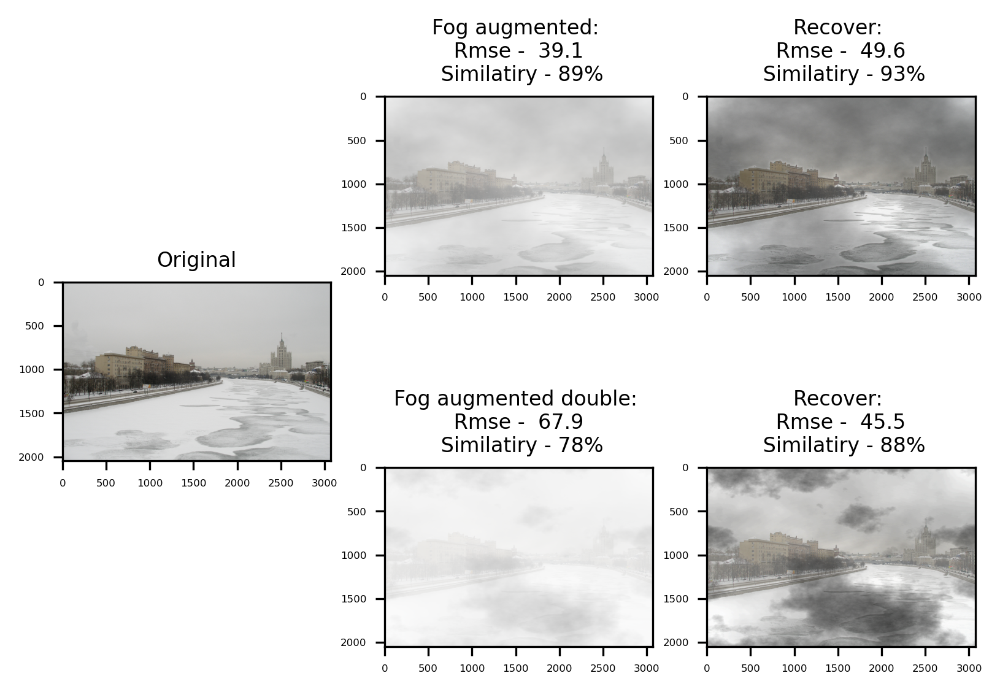

In [9]:
ss_loss = []
mse_loss = []
for img in generated_fog:
    
    src = cv2.imread(img)
    aug = iaa.Fog(random_state = 2023)
    augmented = aug.augment_image(src)
    augmented_double = aug.augment_image(augmented)
    
    dcp_element = DCP(image_path = augmented, kernel_size = 15, tx = 0.1, r = 15, eps = 1e-3, omega = 0.8)
    out_ = dcp_element.apply()
    
    dcp_element = DCP(image_path = augmented_double, kernel_size = 5, tx = 0.15, r = 15, eps = 1e-3, omega = 0.9)
    out_double = dcp_element.apply()
    
    # formating
    rgb_out = cv2.cvtColor(out_.astype('float32'), cv2.COLOR_BGR2RGB)
    rgb_out_double = cv2.cvtColor(out_double.astype('float32'), cv2.COLOR_BGR2RGB)
    
    rgb_src = cv2.cvtColor(src.astype('float32')/255, cv2.COLOR_BGR2RGB)
    
    rgb_aug = cv2.cvtColor(augmented.astype('float32')/255, cv2.COLOR_BGR2RGB)
    rgb_aug_double = cv2.cvtColor(augmented_double.astype('float32')/255, cv2.COLOR_BGR2RGB)
    
    #metrics recover to orig (once)
    out_recover = out_.astype('float64')*255
    mse_recover = mean_squared_error(out_recover, src)
    sim_recover = structural_similarity(out_recover, src, channel_axis = 2, data_range = 255)
    
    # metrics recover to orig (twice)
    out_recover_double = out_double.astype('float64')*255
    mse_recover_double = mean_squared_error(out_recover_double, src)
    sim_recover_double = structural_similarity(out_recover_double, src, channel_axis = 2, data_range = 255)
    
    # metric orig to aug (once)
    mse_aug = mean_squared_error(augmented, src)
    sim_aug = structural_similarity(augmented, src, channel_axis = 2, data_range = 255)
    
    #metrics orig to aug (twice)
    mse_aug_double = mean_squared_error(augmented_double, src)
    sim_aug_double = structural_similarity(augmented_double, src, channel_axis = 2, data_range = 255)
    
    ss_loss.append(sim_recover)
    mse_loss.append(mse_recover)
    
    plt.subplot(1,3,1)
    plt.imshow(rgb_src, cmap = plt.cm.Spectral)
    plt.title('Original', fontsize = 8)

    plt.subplot(2,3,2)
    plt.imshow(rgb_aug, cmap = plt.cm.Spectral)
    plt.title('Fog augmented: \n Rmse -  {:.1f} \n Similatiry - {:.0%}'.format(np.sqrt(mse_aug), sim_aug), fontsize = 8)
    
    plt.subplot(2,3,3)
    plt.imshow(rgb_out, cmap = plt.cm.Spectral)
    plt.title('Recover: \n Rmse -  {:.1f} \n Similatiry - {:.0%}'.format(np.sqrt(mse_recover), sim_recover), fontsize = 8)
    
    plt.subplot(2,3,5)
    plt.imshow(rgb_aug_double, cmap = plt.cm.Spectral)
    plt.title('Fog augmented double: \n Rmse -  {:.1f} \n Similatiry - {:.0%}'.format(np.sqrt(mse_aug_double), sim_aug_double), fontsize = 8)
    
    plt.subplot(2,3,6)
    plt.imshow(rgb_out_double, cmap = plt.cm.Spectral)
    plt.title('Recover: \n Rmse -  {:.1f} \n Similatiry - {:.0%}'.format(np.sqrt(mse_recover_double), sim_recover_double), fontsize = 8)
    
    plt.show()
    

* при снижении ядра фильтра до 15 -> 5
> фото с двойным сгенерированным туманом в среднем восприняли индефирентно - в среднем нулевое изменение по схожести

> фото с единожды сгенерированным туманом - качкство в с реднем упало на 3%
* снижение радиуса с 15 -> 10
> видимых улучшений по качеству не дало 
* усиление dcp фильтра по параметру омега 0.9 -> 0.95
> для пары фотографий с меньшим колиечством нейтрально-бело-серых оттенков (облака здания) уменьшилось качество тк фильтр агрессивнее стал воспринимать возможность наличия тумана

> для фотографий с почти отсутствием таких оттенков качество вырасло на фотографиях с двойным сгенерированным туманом
* ослабление dcp фильтра по параметру омега 0.9 -> 0.8
> эффект обратный предыдущему изменению, лишь для фотографии горы рашмор произошло сильное падаение в качестве - 4%, фотографии с повышенной облачностью (Москва, Лондон, Париж) улучшили качество

> для одиночного тумана лучше ставить 0.8 для двойного 0.9